# Project Airbnb (Step 2)
---

## EDA process

## Agenda

1. Imports
2. Data reading
3. Data Analysis  
4. Time Series
5. NLP analysis
6. Conclusion 

### 1. Imports:
---

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
plt.style.use('seaborn-whitegrid')
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction import text
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from nltk.sentiment.vader import SentimentIntensityAnalyzer

### 2. Data reading:
---

In [2]:
pd.set_option('display.max_columns', None) # to see all the columns on my dataframe
listing= pd.read_json('../data/listing_clean.json')


In [3]:
review =pd.read_json('../data/review_clean.json')

In [4]:
reservations_df =pd.read_json('../data/reservations_clean.json')

* Transforming dtypes to datetime

In [5]:
review['date'] = pd.to_datetime(review['date'])
# https://stackoverflow.com/questions/55440145/pd-to-datetime-valueerror-given-date-string-not-likely-a-datetime

* Creating description_df

In [6]:
# NLP dataframe
description_df= listing[['description','neighborhood_overview','host_about','amenities']].copy()

In [7]:
# creating a new column to see the length of the documents on both dataframe

description_df['description_length'] = description_df['description'].apply(len)
description_df['neighborhood_overview_length'] = description_df['neighborhood_overview'].apply(len)
description_df['host_about_length'] = description_df['host_about'].apply(len)
description_df['amenities_length'] = description_df['amenities'].apply(len)

# creating a new column to see how many words is on the documents on both dataframe

description_df['description_word_count'] = description_df['description'].apply(lambda x: len(x.split()))
description_df['neighborhood_overview_word_count'] = description_df['neighborhood_overview'].apply(lambda x: len(x.split()))
description_df['host_about_word_count'] = description_df['host_about'].apply(lambda x: len(x.split()))
description_df['amenities_word_count'] = description_df['amenities'].apply(lambda x: len(x.split()))

### 3. Data analysis:
---

In [8]:
listing.describe()

,id,host_id,host_is_superhost,latitude,longitude,accommodates,bedrooms,beds,price,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,bathroom
count,3.814900e+04,3.814900e+04,38149.000000,38149.000000,38149.000000,38149.000000,38149.000000,38149.000000,38149.000000,38149.000000,28989.000000,28406.000000,28417.000000,28400.000000,28410.000000,28397.000000,28396.000000,28989.000000,38149.000000
mean,3.022099e+07,1.177421e+08,0.204094,40.729015,-73.948180,2.794936,1.290624,1.567774,159.436027,23.789143,4.593345,4.746377,4.616219,4.813755,4.807952,4.747763,4.647894,1.098895,1.154159
std,1.765137e+07,1.321241e+08,0.403044,0.055899,0.051352,1.870302,0.673828,1.063000,292.580710,50.998635,0.817032,0.486004,0.569397,0.434913,0.458177,0.417239,0.513102,1.767994,0.443529
min,2.595000e+03,2.438000e+03,0.000000,40.504560,-74.249840,1.000000,1.000000,1.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010000,0.000000
25%,1.364263e+07,1.166103e+07,0.000000,40.688920,-73.983080,2.000000,1.000000,1.000000,68.000000,1.000000,4.570000,4.700000,4.500000,4.800000,4.810000,4.670000,4.550000,0.120000,1.000000
50%,3.180068e+07,5.145021e+07,0.000000,40.724770,-73.954320,2.000000,1.000000,1.000000,109.000000,4.000000,4.820000,4.900000,4.800000,4.960000,4.970000,4.870000,4.780000,0.440000,1.000000
75%,4.733639e+07,2.043489e+08,0.000000,40.762540,-73.929510,4.000000,1.000000,2.000000,175.000000,21.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1.530000,1.000000
max,5.416164e+07,4.387934e+08,1.000000,40.914350,-73.710870,16.000000,13.000000,24.000000,10000.000000,1010.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,92.920000,8.000000


In [9]:
listing[['bedrooms','bathroom','beds','price','number_of_reviews','reviews_per_month']].describe()

,bedrooms,bathroom,beds,price,number_of_reviews,reviews_per_month
count,38149.000000,38149.000000,38149.000000,38149.000000,38149.000000,28989.000000
mean,1.290624,1.154159,1.567774,159.436027,23.789143,1.098895
std,0.673828,0.443529,1.063000,292.580710,50.998635,1.767994
min,1.000000,0.000000,1.000000,10.000000,0.000000,0.010000
25%,1.000000,1.000000,1.000000,68.000000,1.000000,0.120000
50%,1.000000,1.000000,1.000000,109.000000,4.000000,0.440000
75%,1.000000,1.000000,2.000000,175.000000,21.000000,1.530000
max,13.000000,8.000000,24.000000,10000.000000,1010.000000,92.920000


In [10]:
reservations_df.describe()

,listings_num_booked,listings_avg_price
count,696.000000,696.000000
mean,14268.729885,160.970179
std,2035.086869,10.552702
min,3847.000000,142.167703
25%,12288.750000,152.012329
50%,13682.000000,156.918168
75%,15764.750000,170.717393
max,18255.000000,184.568790


#### - Price analysis:
---

In [11]:
#price describe
listing[['price']].describe()

,price
count,38149.000000
mean,159.436027
std,292.580710
min,10.000000
25%,68.000000
50%,109.000000
75%,175.000000
max,10000.000000


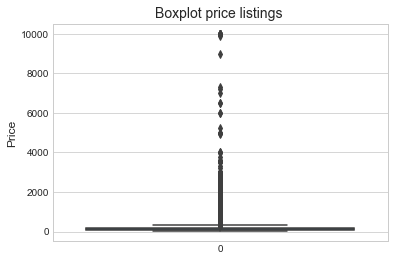

In [12]:
sns.boxplot(data=listing['price']);
plt.title('Boxplot price listings ',fontdict={'fontsize':14});
plt.ylabel('Price',fontdict={'fontsize':12});
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.savefig('../assets/price.png')

* The table above describe the feature *price* of the listing dataframe. The average price of the listings on New York is around 159 dollas per night. The boxplot graphic is a good representation of how is the price distributed, the mayority of the listings are on the average of 159 dollas and there are a few listings that pass that price for that reason the boxplot is shrinking on the avarage. 

In [13]:
# Table of the price per neighborhood by numeber of listings, average price, highest and lowest price
listing.groupby('neighbourhood_group_cleansed')['price'].agg(['count','mean','max'])

,count,mean,max
neighbourhood_group_cleansed,,,
Bronx,1125,101.655111,2000
Brooklyn,14678,132.591497,7184
Manhattan,16575,202.253152,10000
Queens,5431,115.961885,10000
Staten Island,340,116.617647,1200


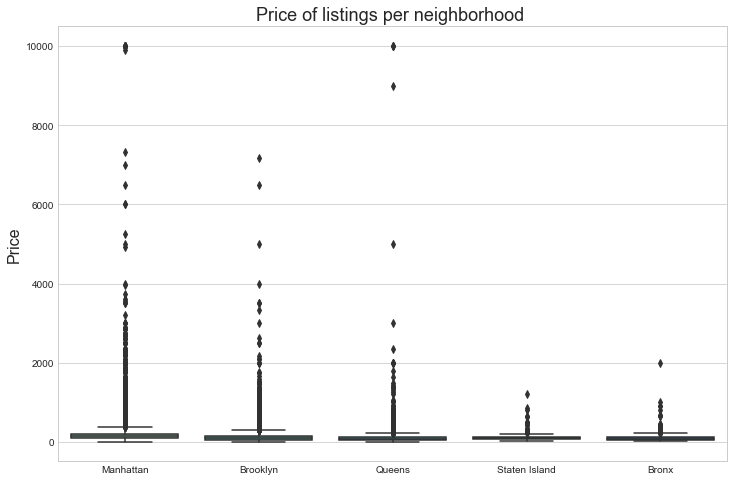

In [14]:
plt.figure(figsize=(12,8))
sns.boxplot(x='neighbourhood_group_cleansed',y = 'price',data=listing,palette="crest");
plt.title('Price of listings per neighborhood ',fontdict={'fontsize':18});
plt.xlabel('');
plt.ylabel('Price',fontdict={'fontsize':16});

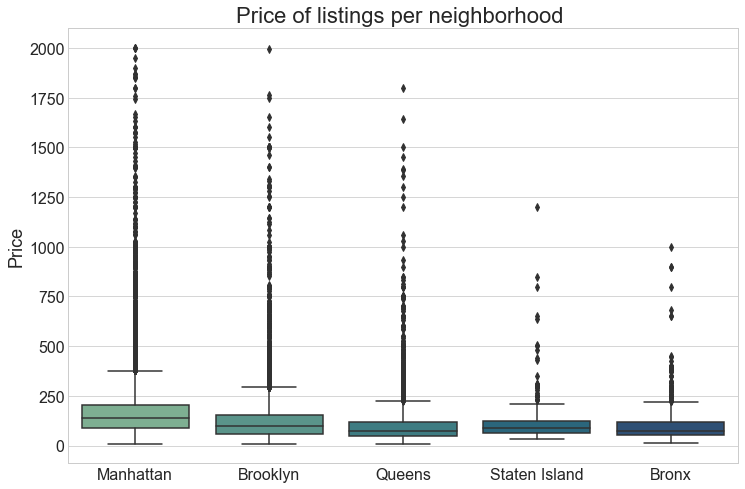

In [15]:
#Price filter < 2000
listings_mean = listing[listing['price']<2000]

plt.figure(figsize=(12,8))
sns.boxplot(x='neighbourhood_group_cleansed',y = 'price',data=listings_mean,palette="crest");
plt.title('Price of listings per neighborhood ',fontdict={'fontsize':22});
plt.xlabel('');
plt.ylabel('Price',fontdict={'fontsize':18});
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('../assets/price_neighborhood.png')

* Manhattan is the neighborhood that has the majority of listings, followed by Brooklyn. The average price in Manhattan is 202 dollars and Brooklyn is 132. the majority of the prices on the boxplot are shrinking between 250 and 100 dollars. Even though Staten Island has the lowest number of listings, Bronx has the lowest average price with 101 dollars.

In [16]:
# Table of the price per accommodates by numeber of listings, average price, highest price
listing.groupby('accommodates')['price'].agg(['count','mean','max','median'])

,count,mean,max,median
accommodates,,,,
1,6545,83.099618,10000,59.0
2,17435,126.980327,10000,95.0
3,3698,158.765819,2750,131.0
4,5848,213.040869,10000,153.0
5,1516,230.389842,2695,182.0
6,1723,287.161346,6000,203.0
7,347,355.881844,6500,236.0
8,517,373.735010,2500,275.0
9,62,504.806452,3000,317.5


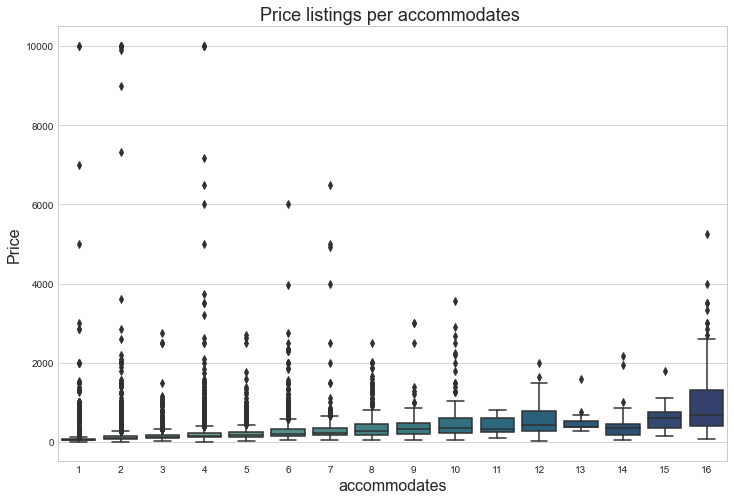

In [17]:

plt.figure(figsize=(12,8))
sns.boxplot(x='accommodates',y='price',data=listing,palette="crest");
plt.title('Price listings per accommodates ',fontdict={'fontsize':18});
plt.xlabel('accommodates',fontdict={'fontsize':16});
plt.ylabel('Price',fontdict={'fontsize':16});

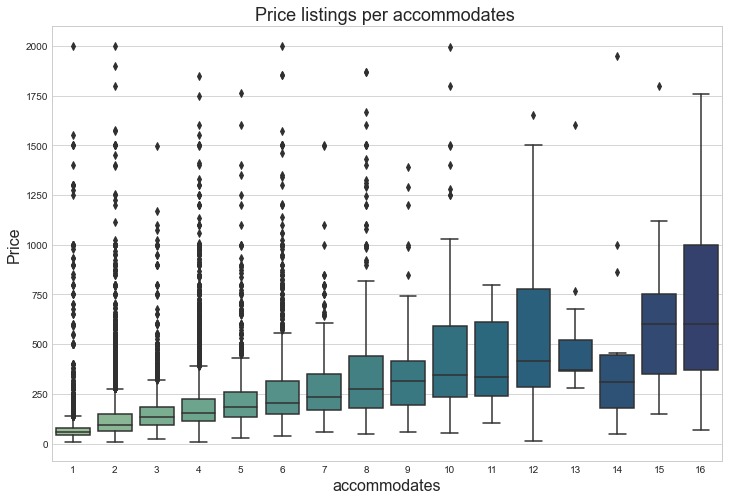

In [18]:
listings_mean = listing[listing['price']<2000] #Price filter < 2000
plt.figure(figsize=(12,8))
sns.boxplot(x='accommodates',y='price',data=listings_mean,palette="crest");
plt.title('Price listings per accommodates ',fontdict={'fontsize':18});
plt.xlabel('accommodates',fontdict={'fontsize':16});
plt.ylabel('Price',fontdict={'fontsize':16});
plt.savefig('../assets/price_accommodates.png')

* The range of accommodation varies between 1 and 16 people. Most listings in new york are for 2 people with an average price of 120 dollars per night, and for 16 people the average price is 1026 per night. As the number of accommodations increases, the average price also increases, approximately between 30 and 100 dollars per night.

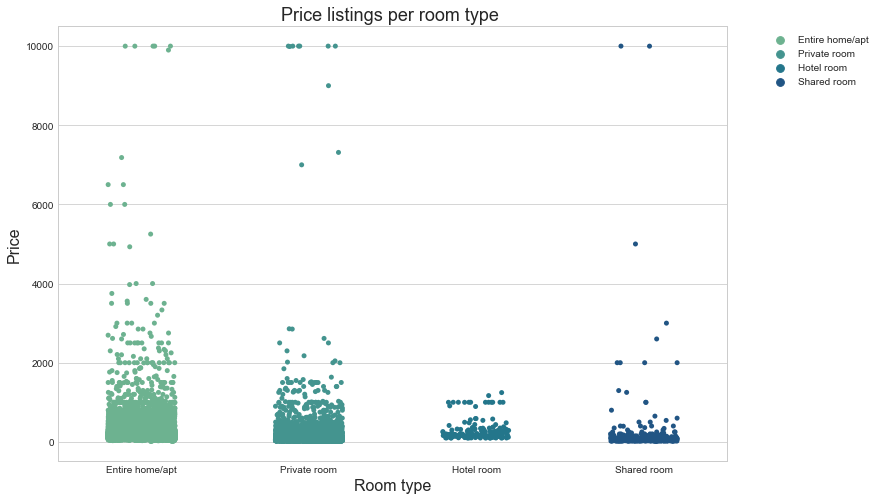

In [19]:
plt.figure(figsize=(12,8))

ax=sns.stripplot(x="room_type",y="price",hue="room_type",data=listing,jitter=0.2,orient="v",palette="crest")
plt.title('Price listings per room type ',fontdict={'fontsize':18});
plt.xlabel('Room type',fontdict={'fontsize':16});
plt.ylabel('Price',fontdict={'fontsize':16});
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left');
plt.savefig('../assets/room_type.png')

* There are 4 types of rooms (Entire home/apt, private room, hotel room, and shared room). The hotel room has the lowest price of the other types of rooms. Most of the listings are the entire house and for the private room.

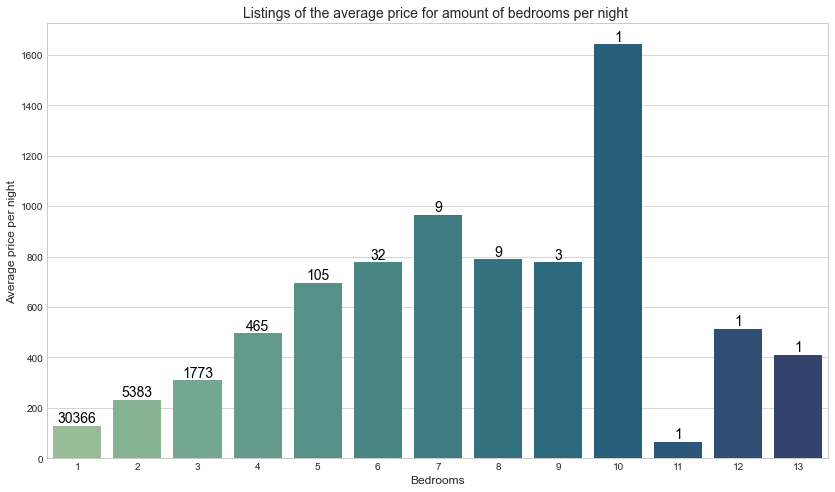

In [20]:
order= listing.groupby(listing['bedrooms']).agg({'price':'mean','bedrooms':'count'})
order.rename(columns={'bedrooms':'count'},inplace=True)
order=pd.DataFrame(order)
order.reset_index(inplace=True)
plt.figure(figsize=(14,8))

ax=sns.barplot(x='bedrooms',y='price',data=order,palette="crest");
plt.title('Listings of the average price for amount of bedrooms per night ',fontdict={'fontsize':14});
plt.xlabel('Bedrooms',fontdict={'fontsize':12})
plt.ylabel('Average price per night',fontdict={'fontsize':12})
for i, bar in enumerate(ax.patches):
    ax.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1.5,
            f"{order['count'][i]}",
            horizontalalignment= 'center', verticalalignment='bottom',
            fontsize=14, color='black')
    
plt.savefig('../assets/bedrooms.png')
#https://es.stackoverflow.com/questions/188701/indicar-datos-en-grafico-de-barras-con-matplotlib

In [21]:
listing[listing['bedrooms']==11]

,id,listing_url,name,description,neighborhood_overview,host_id,host_name,host_location,host_about,host_is_superhost,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,bathroom
15029,23124338,https://www.airbnb.com/rooms/23124338,New York Guests House,"Beautiful peaceful, quiet, clean 11 private r...",None,171830071,Fatima,US,None,0,Fordham,Bronx,40.85534,-73.89733,Private room in guesthouse,Private room,16,2 shared baths,11,21,"[""Cable TV"", ""Hot water"", ""TV with standard ca...",66,5,3.75,4.0,4.25,4.25,4.0,4.0,3.75,0.11,2.0


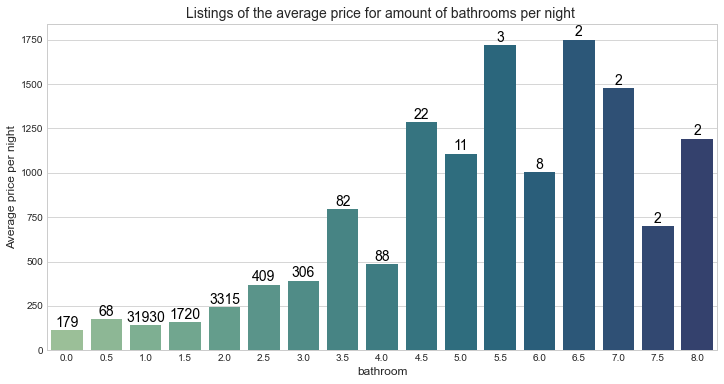

In [22]:
order= listing.groupby(listing['bathroom']).agg({'price':'mean','bathroom':'count'})
order.rename(columns={'bathroom':'count'},inplace=True)
order=pd.DataFrame(order)
order.reset_index(inplace=True)
plt.figure(figsize=(12,6))

ax=sns.barplot(x='bathroom',y='price',data=order,palette="crest");
plt.title('Listings of the average price for amount of bathrooms per night ',fontdict={'fontsize':14});
plt.xlabel('bathroom',fontdict={'fontsize':12})
plt.ylabel('Average price per night',fontdict={'fontsize':12});
for i, bar in enumerate(ax.patches):
    ax.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1.5,
            f"{order['count'][i]}",
            horizontalalignment= 'center', verticalalignment='bottom',
            fontsize=14, color='black')

* On the 2 previous graphics of the bedrooms and bathrooms. Looking at the graph we can see the number of rooms per listing and the number of listings per room. most listings have only 1 room with a total of 30366. We see that as the number of rooms increases the number of listings decreases.   

---

#### - Listings per neighborhood :
---

In [23]:
# Analysis of the neighbourhood by number of reviews and price
listing.groupby('neighbourhood_group_cleansed').agg({'number_of_reviews':['count','sum','mean','max'],'price':['mean','max','min']})

number_of_reviews                           \
                                         count     sum       mean   max   
neighbourhood_group_cleansed                                              
Bronx                                     1125   31563  28.056000   445   
Brooklyn                                 14678  389120  26.510424   678   
Manhattan                                16575  317654  19.164646  1010   
Queens                                    5431  156337  28.786043   682   
Staten Island                              340   12858  37.817647   373   

                                   price             
                                    mean    max min  
neighbourhood_group_cleansed                         
Bronx                         101.655111   2000  11  
Brooklyn                      132.591497   7184  10  
Manhattan                     202.253152  10000  10  
Queens                        115.961885  10000  10  
Staten Island                 116.617647   1200  31

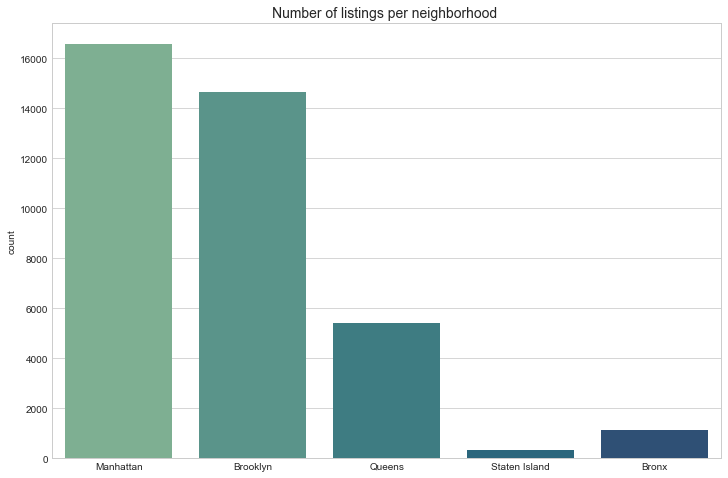

In [24]:
# Graphic of number of listings per neighborhood
plt.figure(figsize=(12,8))
sns.countplot(x='neighbourhood_group_cleansed',data=listing,palette="crest");
plt.title('Number of listings per neighborhood ',fontdict={'fontsize':14});
plt.xlabel('');


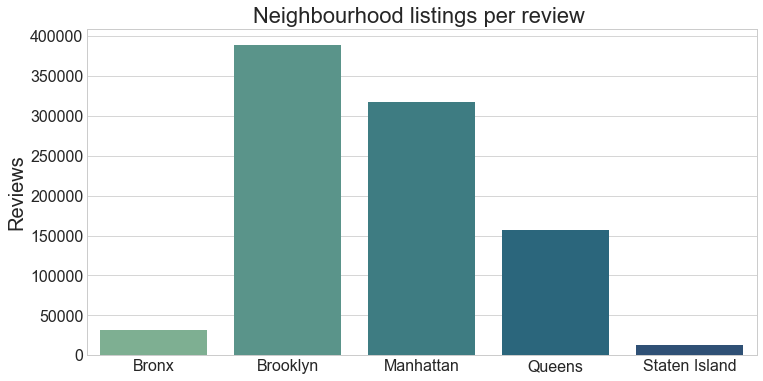

In [25]:
order=listing.groupby('neighbourhood_group_cleansed').agg({'number_of_reviews':'sum'})
order=pd.DataFrame(order)
order.reset_index(inplace=True)
plt.figure(figsize=(12,6))

ax=sns.barplot(x='neighbourhood_group_cleansed',y='number_of_reviews',data=order,palette="crest");
plt.title('Neighbourhood listings per review ',fontdict={'fontsize':22});
plt.xlabel('');
plt.ylabel('Reviews',fontdict={'fontsize':20});
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('../assets/neig_reviews.png')

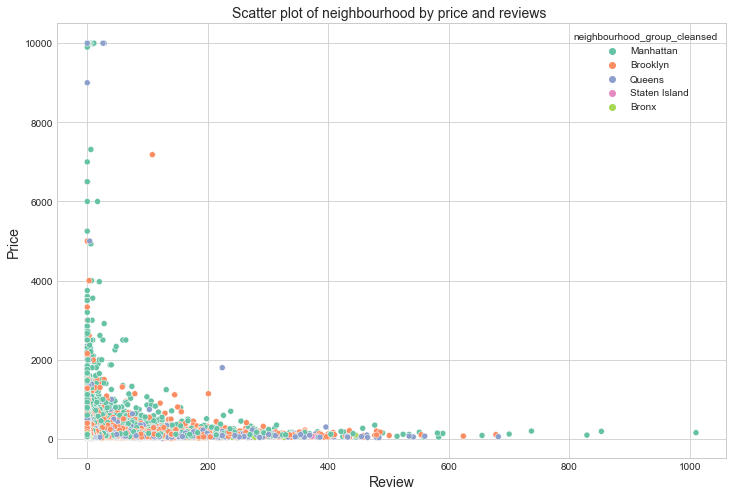

In [26]:
#  Graphic Scatter plot of neighbourhood by price and reviews
plt.figure(figsize=(12,8))
ax = sns.scatterplot(x="number_of_reviews", y="price",hue="neighbourhood_group_cleansed",palette='Set2',data=listing)
plt.title('Scatter plot of neighbourhood by price and reviews ',fontdict={'fontsize':14});
plt.xlabel('Review',fontdict={'fontsize':14});
plt.ylabel('Price',fontdict={'fontsize':14});

* Analyzing the graphs above, we have 5 neighborhoods in the listings, Bronx, Brooklyn, Manhattan, Queens and Staten Island. the neighborhood with the highest number of reviews is Brooklyn with a number of 389120, although it is not the neighborhood with the highest number of listings. In the scatterplot graph we can see that it makes a type of exponential figure, this is due to the fact that as the price of the listing increases, the number of reviews decreases.

---

#### - Type of listings, number of accommodates and superhost:
---

##### Type of listings:

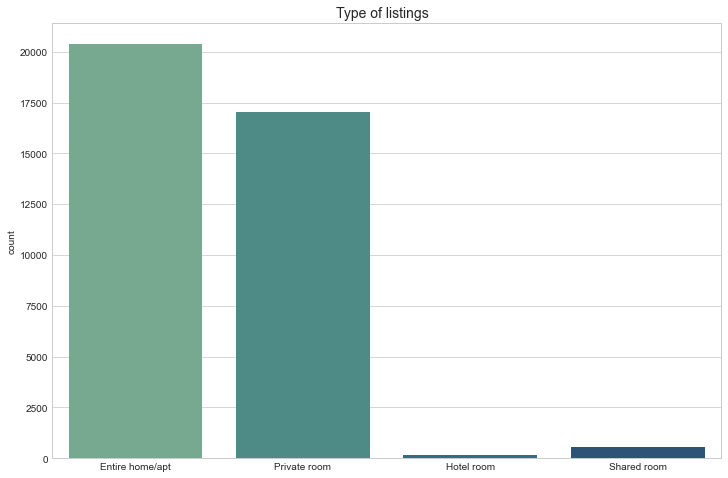

In [27]:
plt.figure(figsize=(12,8))
sns.countplot(x='room_type',data=listing,palette="crest");
plt.title('Type of listings  ',fontdict={'fontsize':14});
plt.xlabel('',fontdict={'fontsize':12});

##### Number of accommodates per listings:

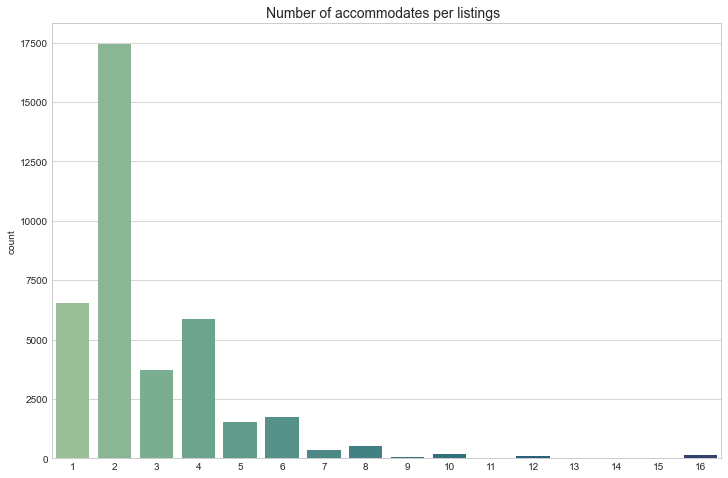

In [28]:
plt.figure(figsize=(12,8))
sns.countplot(x='accommodates',data=listing,palette="crest");
plt.title('Number of accommodates per listings  ',fontdict={'fontsize':14});
plt.xlabel('',fontdict={'fontsize':12});

#####  Superhost:

A Superhost is someone who goes above and beyond in their hosting duties and is a shining example of how a Host should be. You can easily identify one from the badge that appears on their listing and profile.

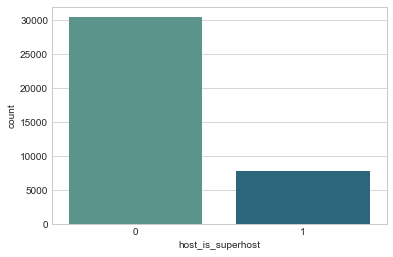

In [29]:
ax=sns.countplot( x="host_is_superhost", data=listing, palette="crest")

#### - Map grafics:

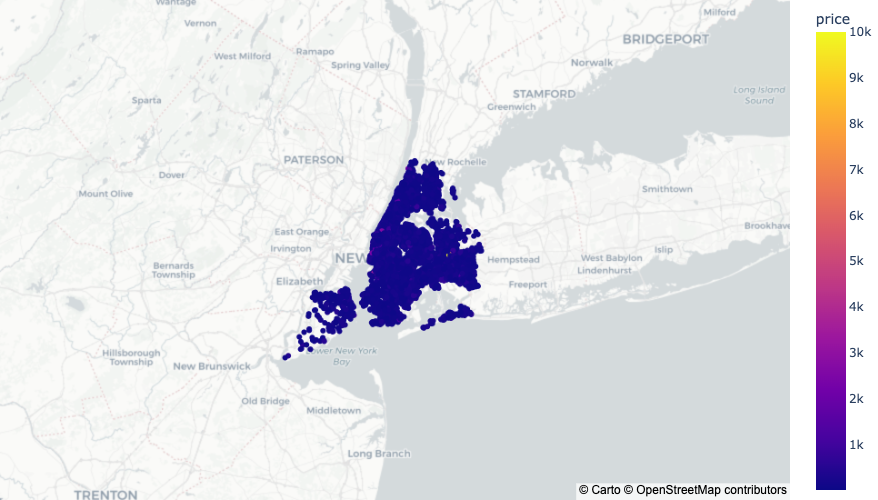

In [30]:
fig = px.scatter_mapbox(listing,lat='latitude',
    lon='longitude',
    color='price',mapbox_style="carto-positron",width=800, height=500)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

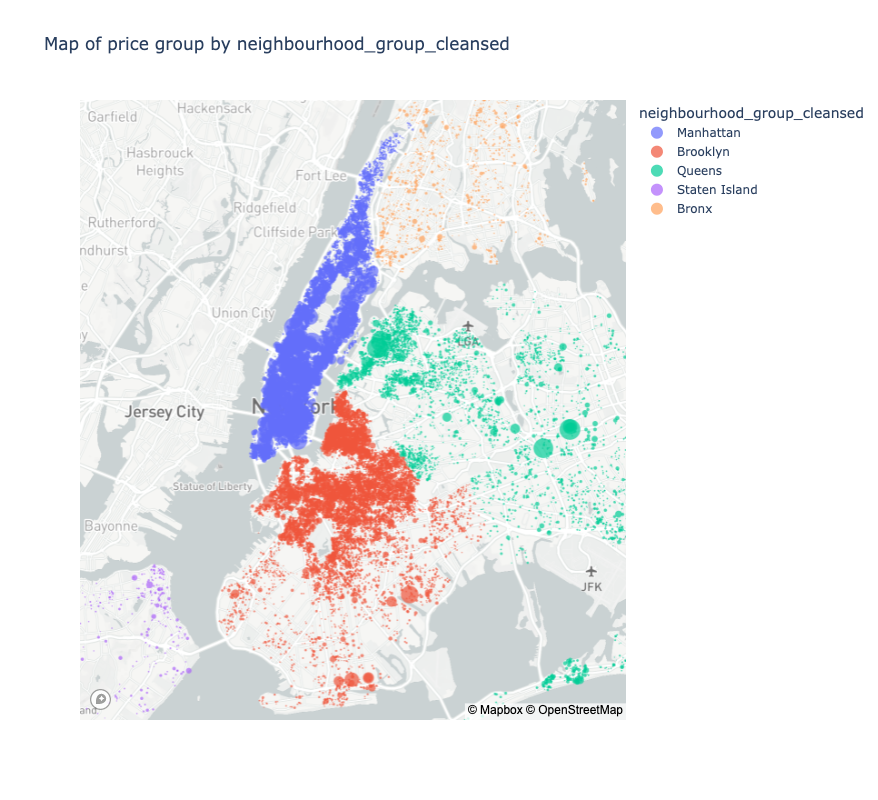

In [31]:
px.set_mapbox_access_token('pk.eyJ1IjoiemFja3NhbWJlciIsImEiOiJjazc3MXI1NjQwMXIzM25vMnBtMWtpNWFjIn0.FHxYZnEoStWmap8EQe2l-g')
fig = px.scatter_mapbox(listing, 
                        lat='latitude', 
                        lon='longitude',
                        color='neighbourhood_group_cleansed', 
                        size='price', 
                        color_continuous_scale=px.colors.cyclical.IceFire, 
                        hover_name='id',
                        hover_data=['listing_url', 'property_type', 'room_type'],
                        size_max=15, 
                        zoom=10,
                        title='Map of price group by neighbourhood_group_cleansed',width=1200, height=800)
fig.show()
#https://plotly.com/python/scattermapbox/#multiple-markers

### 4. Time series:
---

In [32]:
reservations_df.head(2)

,listings_num_booked,listings_avg_price,weekday
2021-02-05,3847,149.310480,Friday
2021-02-06,9204,145.043317,Saturday


#### - Price:
---

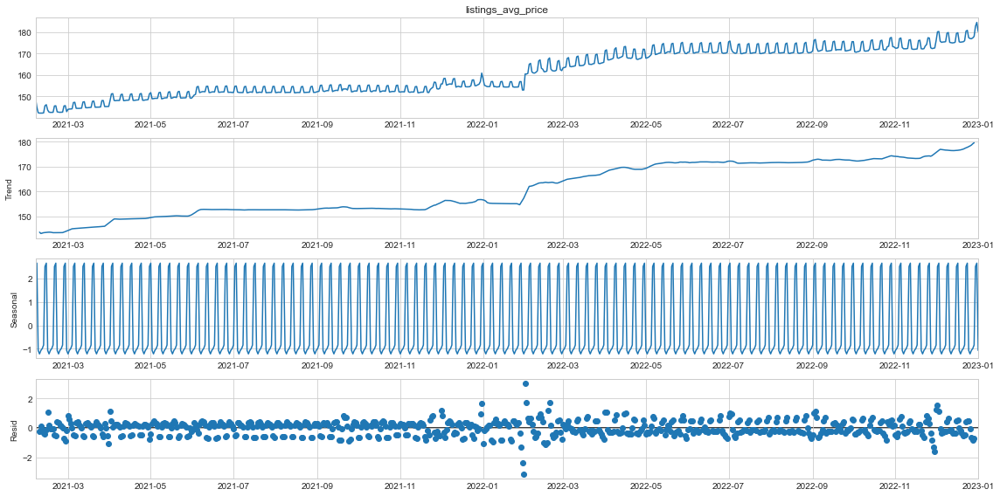

In [33]:
decomp = seasonal_decompose(reservations_df['listings_avg_price'])

plt.rc("figure", figsize=(16,8))
# Plot the decomposed time series.
decomp.plot();


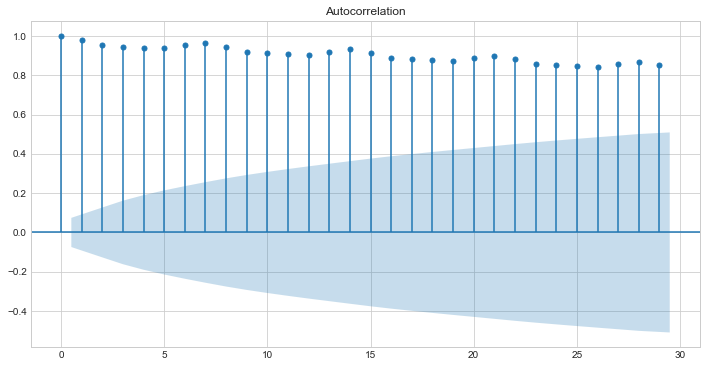

In [34]:
N, M = 12, 6
fig, ax = plt.subplots(figsize=(N, M))
plot_acf(reservations_df['listings_avg_price'],ax=ax);


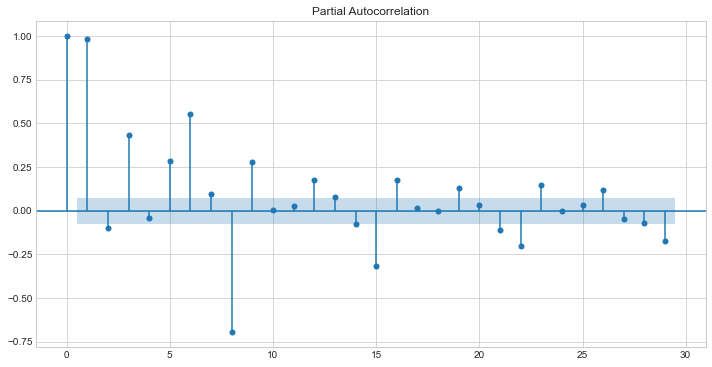

In [35]:
N, M = 12, 6
fig, ax = plt.subplots(figsize=(N, M))
plot_pacf(reservations_df['listings_avg_price'],ax=ax);


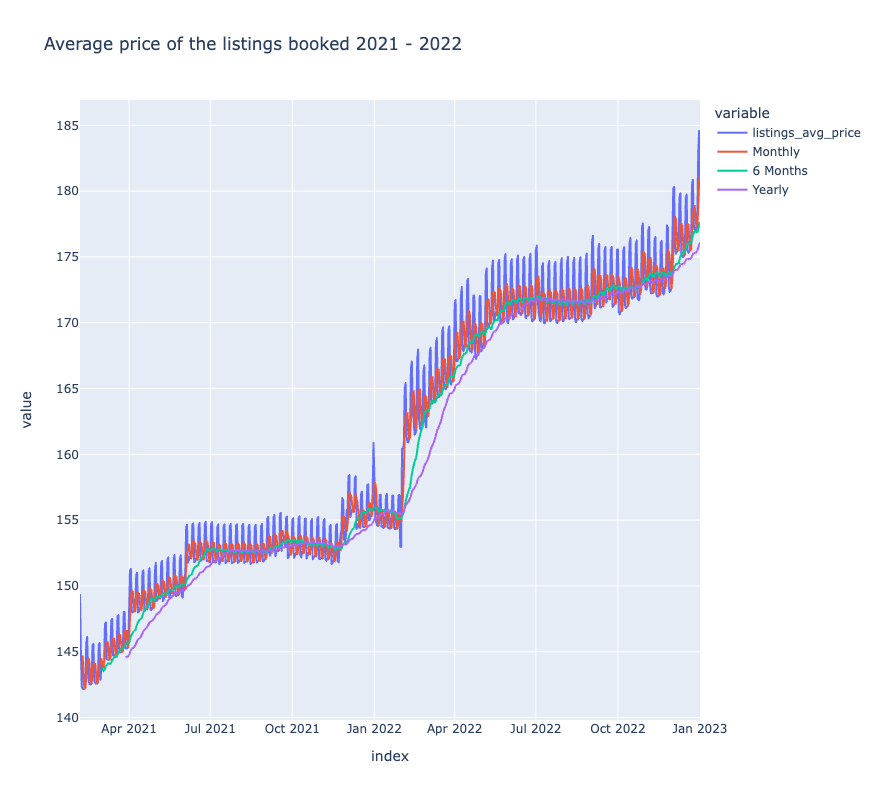

In [36]:
reservations_df['Monthly']=reservations_df['listings_avg_price'].rolling(4).mean()
reservations_df['6 Months']=reservations_df['listings_avg_price'].rolling(26).mean()
reservations_df['Yearly']=reservations_df['listings_avg_price'].rolling(52).mean()

fig = px.line(reservations_df,  y=[reservations_df['listings_avg_price'],reservations_df['Monthly'],reservations_df['6 Months'],reservations_df['Yearly']]
              ,width=1300, height=800,title='Average price of the listings booked 2021 - 2022') 

fig.show()

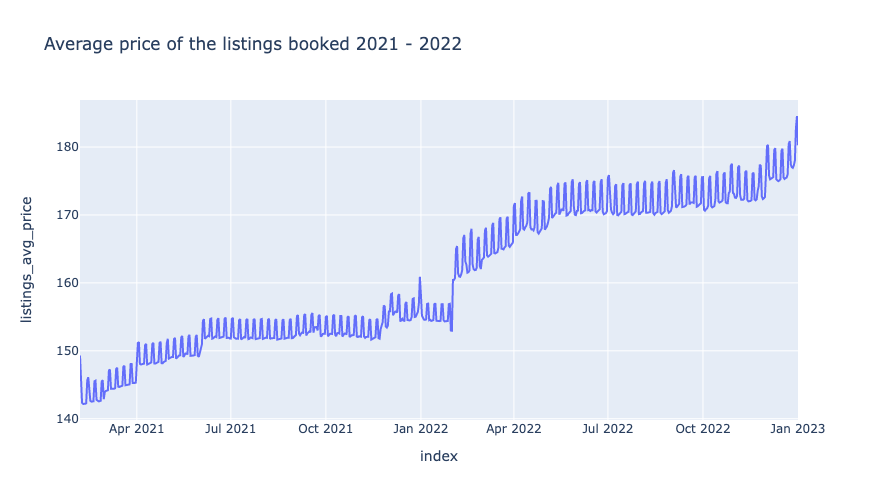

In [37]:
fig = px.line(reservations_df,  y="listings_avg_price",width=1000, height=500,title='Average price of the listings booked 2021 - 2022')
fig.show()

In the graphs above we have the price of the listings during a period of time of 2 years. we see that the price has a positive trend, by breaking down the time and using the statsmodels function we can confirm that there is a positive trend and that the price is also seasonality

* Time series February 2022
---

In [38]:
months_df = reservations_df
months_df=months_df.resample('M').mean()
months_df.reset_index(inplace=True)
months_df.rename(columns={'index':'date'},inplace=True)
months_df['months'] = months_df['date'].dt.month_name()

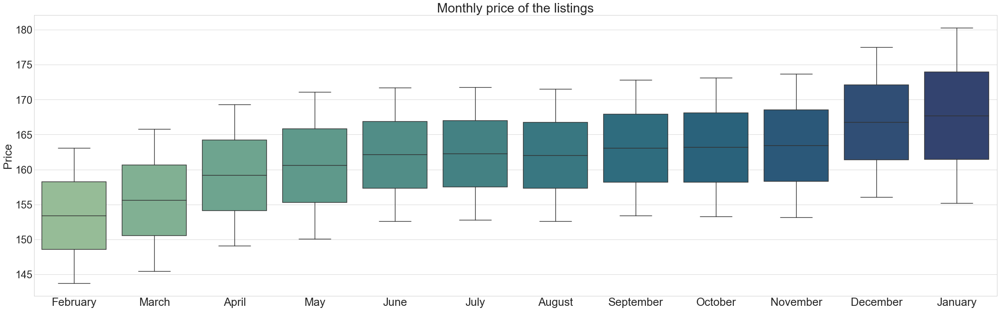

In [39]:
fig, ax = plt.subplots(figsize=(40, 12))

sns.boxplot(x='months',y='listings_avg_price',data=months_df,palette="crest")
plt.title('Monthly price of the listings',fontdict={'fontsize':30});
plt.xlabel('',fontdict={'fontsize':12});
plt.ylabel('Price',fontdict={'fontsize':26})
plt.yticks(fontsize=24)
plt.xticks(fontsize=26);
plt.savefig('../assets/time_series_price_month.png')

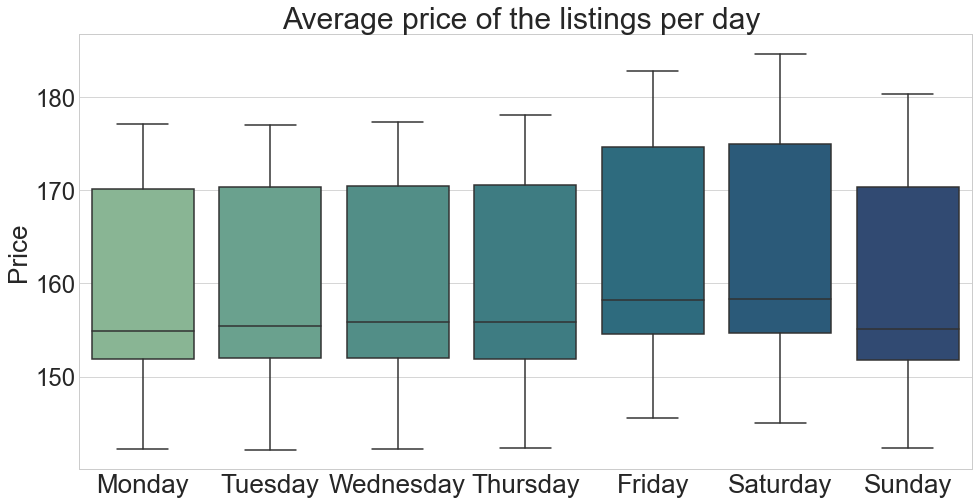

In [40]:
order=['Monday', 'Tuesday', 'Wednesday', 'Thursday','Friday','Saturday', 'Sunday']
plt.figure(figsize=(16,8))
sns.boxplot(x='weekday',y='listings_avg_price',data=reservations_df,order=order,palette="crest");
plt.title('Average price of the listings per day ',fontdict={'fontsize':30});
plt.xlabel('');
plt.ylabel('Price',fontdict={'fontsize':26})
plt.yticks(fontsize=24)
plt.xticks(fontsize=26);
plt.savefig('../assets/time_series_price_day.png')

In [41]:
feb_2022_df=reservations_df.loc['2022-02']

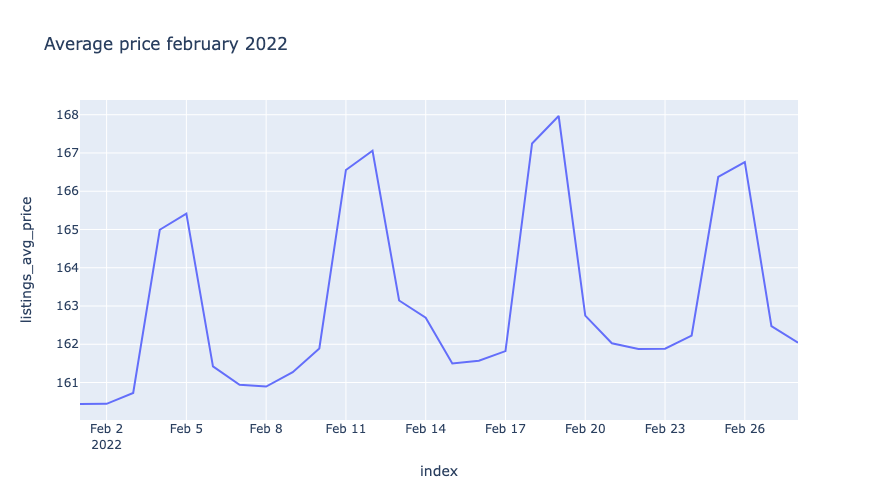

In [42]:
fig = px.line(feb_2022_df,  y="listings_avg_price",width=1000, height=500,title='Average price february 2022  ')
fig.show()

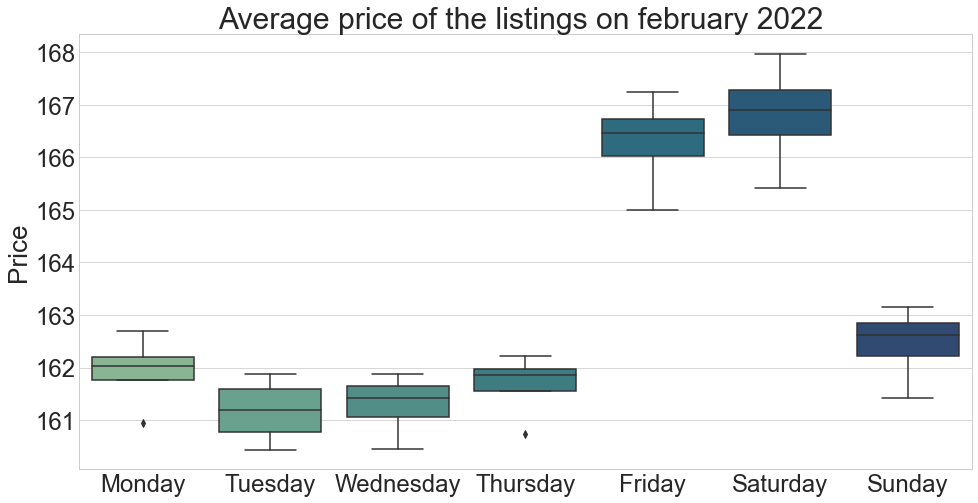

In [43]:
order=['Monday', 'Tuesday', 'Wednesday', 'Thursday','Friday','Saturday', 'Sunday']
plt.figure(figsize=(16,8))
sns.boxplot(x='weekday',y='listings_avg_price',data=feb_2022_df,order=order,palette="crest");
plt.title('Average price of the listings on february 2022 ',fontdict={'fontsize':30});
plt.xlabel('');
plt.ylabel('Price',fontdict={'fontsize':26})
plt.yticks(fontsize=24)
plt.xticks(fontsize=24);
plt.xlabel('',fontdict={'fontsize':12});

* The graphs show that the price of the listings there is a positive trend, it also seems to be stationary. In the boxplot of the monthly price there is a continuous increase in the price each month, also when the graph is analyzed by weekly we can see that there is a stationary function, which increases the price only on weekends.

#### - Available:
---

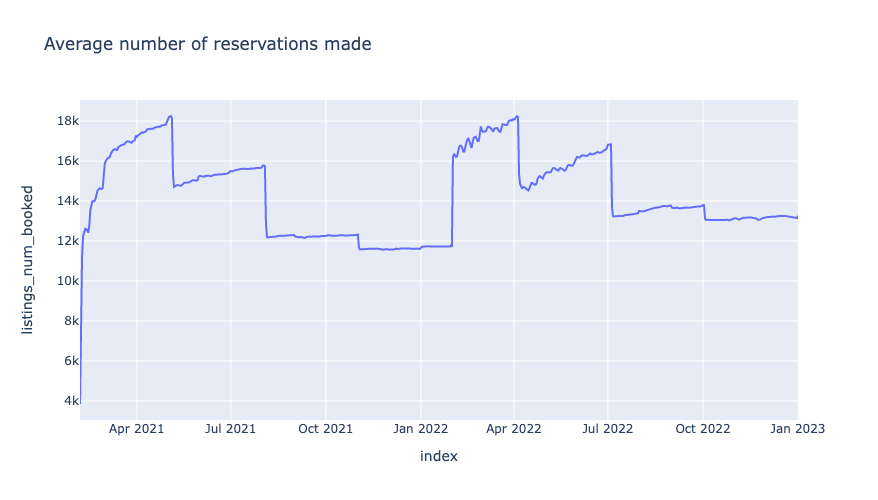

In [44]:
fig = px.line(reservations_df,  y="listings_num_booked",width=1000, height=500,title='Average number of reservations made')
fig.show()

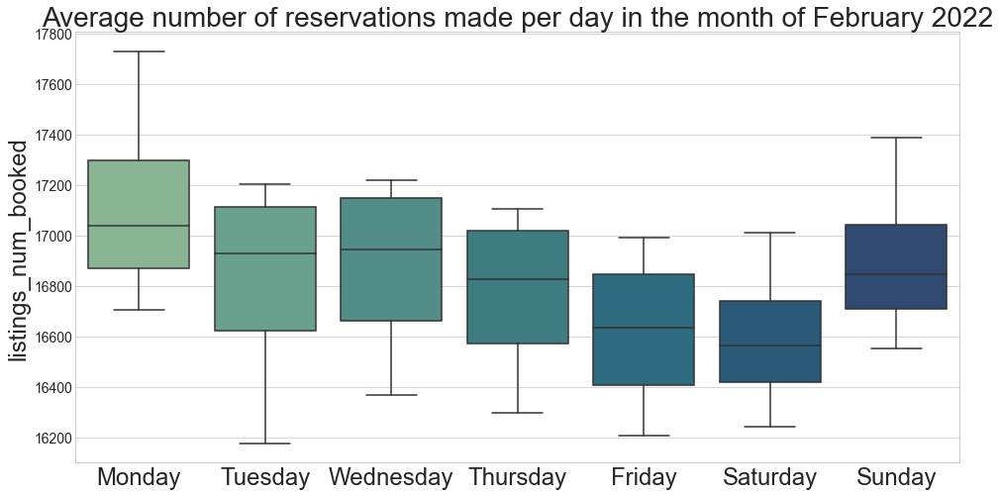

In [45]:
order=['Monday', 'Tuesday', 'Wednesday', 'Thursday','Friday','Saturday', 'Sunday']
plt.figure(figsize=(16,8))
sns.boxplot(x='weekday',y='listings_num_booked',data=feb_2022_df,order=order,palette="crest");
plt.title('Average number of reservations made per day in the month of February 2022',fontdict={'fontsize':28});
plt.xlabel('');
plt.ylabel('listings_num_booked',fontdict={'fontsize':24})
plt.yticks(fontsize=14)
plt.xticks(fontsize=24);
plt.savefig('../assets/time_series_reservations_day.png')

* When the availability of reservations is analyzed in a time series, a graph of descending scales is formed, this is because the reservation data has been taken on two dates (2021-02-05 to 2022-01- 31 and 2022-02-01 to 2023-01-05). As time goes by, reservations also drop. If we analyze the reservations for the month of February 2022, we can see that it is the opposite case of the price, the reservations during the weekend go down.

### 5. NLP analysis:
---

* ####  Description listings:
---

In [46]:
description_df.head(2)

,description,neighborhood_overview,host_about,amenities,description_length,neighborhood_overview_length,host_about_length,amenities_length,description_word_count,neighborhood_overview_word_count,host_about_word_count,amenities_word_count
0,"Beautiful, spacious skylit studio in the heart...",Centrally located in the heart of Manhattan ju...,A New Yorker since 2000! My passion is creatin...,"[""Hot water"", ""Iron"", ""Keypad"", ""Refrigerator""...",1000,217,427,530,151,36,67,61
1,"Enjoy 500 s.f. top floor in 1899 brownstone, w...",Just the right mix of urban center and local n...,Laid-back Native New Yorker (formerly bi-coast...,"[""Hot water"", ""Iron"", ""Children\u2019s books a...",1000,258,220,621,165,48,35,74


In [47]:
my_stop_words = text.ENGLISH_STOP_WORDS.union(["br"])
#https://stackoverflow.com/questions/26826002/adding-words-to-stop-words-list-in-tfidfvectorizer-in-sklearn

In [48]:
# Instantiate a CountVectorizer stop_words as a parameter

cv_1 = CountVectorizer(stop_words=my_stop_words,max_features=1_000,min_df=2)
description_vect = cv_1.fit_transform(description_df['description']) # Fit and transform the variable vectorizer with the corpus
description_vect_df = pd.DataFrame(description_vect.todense(), columns=cv_1.get_feature_names()) # creating a new Dataframe


cv_2 = CountVectorizer(stop_words=my_stop_words,max_features=1_000,min_df=2)
neighborhood_overview_vect = cv_2.fit_transform(description_df['neighborhood_overview']) # Fit and transform the variable vectorizer with the corpus
neighborhood_overview_vect_df = pd.DataFrame(neighborhood_overview_vect.todense(), columns=cv_2.get_feature_names()) # creating a new Dataframe

cv_3 = CountVectorizer(stop_words=my_stop_words,max_features=1_000,min_df=2)
host_about_vect = cv_3.fit_transform(description_df['host_about']) # Fit and transform the variable vectorizer with the corpus
host_about_vect_df = pd.DataFrame(host_about_vect.todense(), columns=cv_3.get_feature_names()) # creating a new Dataframe

cv_4 = CountVectorizer(stop_words=my_stop_words,max_features=1_000,min_df=2)
amenities_vect = cv_4.fit_transform(description_df['amenities']) # Fit and transform the variable vectorizer with the corpus
amenities_vect_df = pd.DataFrame(amenities_vect.todense(), columns=cv_4.get_feature_names()) # creating a new Dataframe

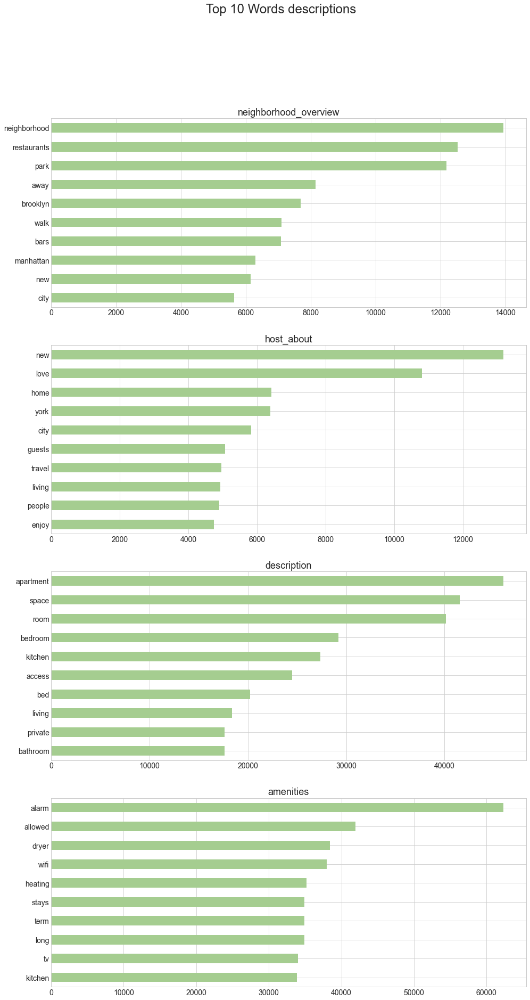

In [49]:
# Graphic of the words more common

fig, ax = plt.subplots(4, 1, figsize=(16,30))
neighborhood_overview_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[0], fontsize=14,colormap='crest').invert_yaxis()
host_about_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[1], fontsize=14,colormap='crest').invert_yaxis()
description_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[2], fontsize=14,colormap='crest').invert_yaxis()
amenities_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[3], fontsize=14,colormap='crest').invert_yaxis()

ax[0].set_title('neighborhood_overview', fontsize=18)
ax[1].set_title('host_about', fontsize=18)
ax[2].set_title('description', fontsize=18)
ax[3].set_title('amenities', fontsize=18)

fig.suptitle('Top 10 Words descriptions', fontsize=24);


In [50]:
# Instantiate a CountVectorizer stop_words as a parameter

cv_1 = CountVectorizer(stop_words=my_stop_words,ngram_range=(2,2),max_features=1_000,min_df=2)
description_vect = cv_1.fit_transform(description_df['description'])
description_vect_df = pd.DataFrame(description_vect.todense(), columns=cv_1.get_feature_names())

cv_2 = CountVectorizer(stop_words=my_stop_words,ngram_range=(2,2),max_features=1_000,min_df=2)
neighborhood_overview_vect = cv_2.fit_transform(description_df['neighborhood_overview'])
neighborhood_overview_vect_df = pd.DataFrame(neighborhood_overview_vect.todense(), columns=cv_2.get_feature_names())

cv_3 = CountVectorizer(stop_words=my_stop_words,ngram_range=(2,2),max_features=1_000,min_df=2)
host_about_vect = cv_3.fit_transform(description_df['host_about'])
host_about_vect_df = pd.DataFrame(host_about_vect.todense(), columns=cv_3.get_feature_names())

cv_4 = CountVectorizer(stop_words=my_stop_words,ngram_range=(2,2),max_features=1_000,min_df=2)
amenities_vect = cv_4.fit_transform(description_df['amenities'])
amenities_vect_df = pd.DataFrame(amenities_vect.todense(), columns=cv_4.get_feature_names())

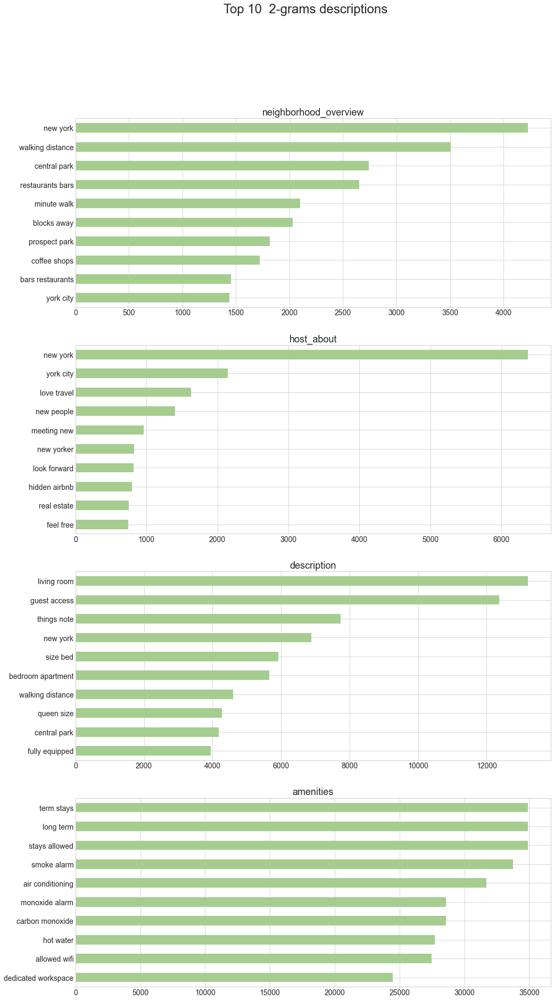

In [51]:
# Graphic of the words more common

fig, ax = plt.subplots(4, 1, figsize=(16,30))
neighborhood_overview_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[0], fontsize=14,colormap='crest').invert_yaxis()
host_about_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[1], fontsize=14,colormap='crest').invert_yaxis()
description_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[2], fontsize=14,colormap='crest').invert_yaxis()
amenities_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', ax=ax[3], fontsize=14,colormap='crest').invert_yaxis()

ax[0].set_title('neighborhood_overview', fontsize=18)
ax[1].set_title('host_about', fontsize=18)
ax[2].set_title('description', fontsize=18)
ax[3].set_title('amenities', fontsize=18)

fig.suptitle('Top 10  2-grams descriptions', fontsize=24);

* In the graphs above we see the words most used by hosted to describe their listings. It seems to be important that the listings are close to places like restaurants, parks or bars. Another important thing to keep in mind is that in the amenities the words that appear most frequently are alarm.

* #### Reviews:
---

In [52]:
review

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,2595,17857,2009-11-21,50679,Jean,Notre séjour de trois nuits.\r<br/>Nous avons ...
1,2595,19176,2009-12-05,53267,Cate,Great experience.
2,2595,19760,2009-12-10,38960,Anita,I've stayed with my friend at the Midtown Cast...
3,2595,34320,2010-04-09,71130,Kai-Uwe,"We've been staying here for about 9 nights, en..."
4,2595,46312,2010-05-25,117113,Alicia,We had a wonderful stay at Jennifer's charming...
...,...,...,...,...,...,...
908798,54068505,530466336014849638,2022-01-01,139101549,혜림,This accommodation is really spacious and cozy...
908799,54068618,531889072617957364,2022-01-03,269891056,Muhammad Sumon,"Trenton is a very polite, supportive and nice ..."
908800,54069262,531156827278928554,2022-01-02,334754376,Rosie,The place looks nothing like the way it looks ...
908801,54070458,532622557240773786,2022-01-04,413792949,Benjy,I will recommend this place to anyone going to...


In [53]:
cv_ = CountVectorizer(stop_words=my_stop_words,max_features=1_000,min_df=2)
review_vect = cv_.fit_transform(review['comments'])
review_vect_df = pd.DataFrame(review_vect.todense(), columns=cv_.get_feature_names())

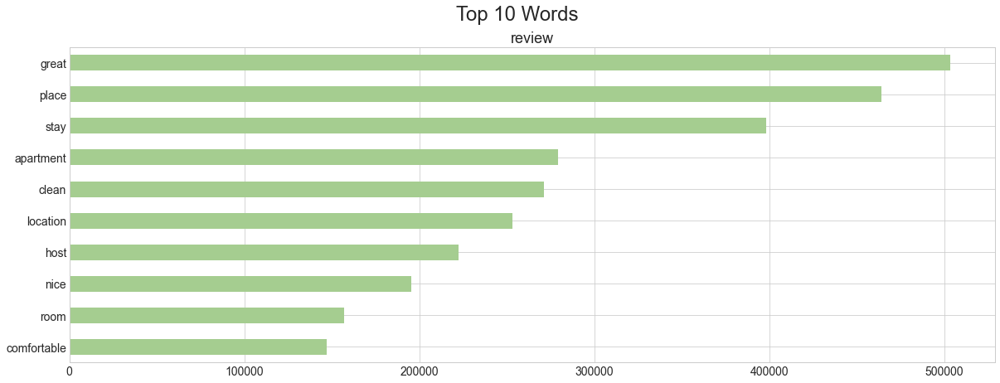

In [54]:
# Graphic of the words more common

fig, ax = plt.subplots(figsize=(20,7))
review_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', fontsize=14,colormap='crest').invert_yaxis()


plt.title('review', fontsize=18)

fig.suptitle('Top 10 Words', fontsize=24);
plt.savefig('../assets/nlpreviews.png')

In [55]:
cv3 = CountVectorizer(stop_words=my_stop_words,ngram_range=(2,2),max_features=1_000,min_df=2)
review_vectb = cv3.fit_transform(review['comments'])
review_vectb_df = pd.DataFrame(review_vectb.todense(), columns=cv3.get_feature_names())

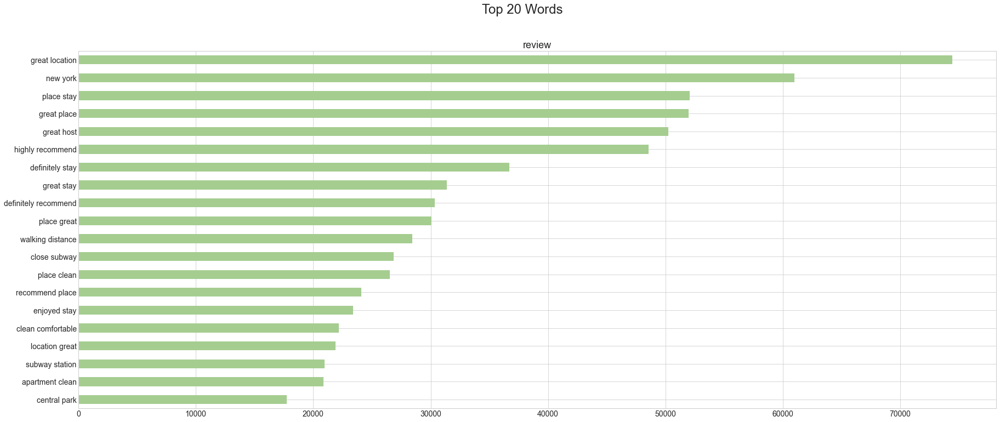

In [56]:
fig, ax = plt.subplots(figsize=(30,12))
review_vectb_df.sum().sort_values(ascending=False).head(20).plot(kind='barh', fontsize=14,colormap='crest').invert_yaxis()


plt.title('review', fontsize=18)

fig.suptitle('Top 20 Words', fontsize=24);

In [57]:
cv7 = CountVectorizer(stop_words=my_stop_words,ngram_range=(3,3),max_features=1_000,min_df=2)
review_vectb = cv7.fit_transform(review['comments'])
review_vectb_df = pd.DataFrame(review_vectb.todense(), columns=cv7.get_feature_names())

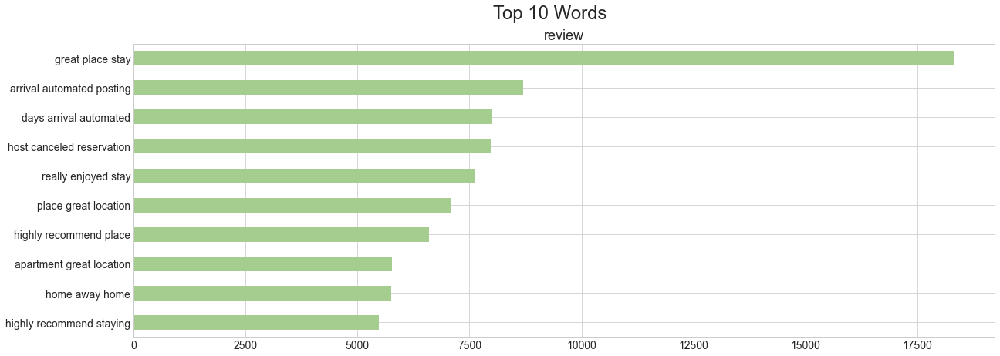

In [58]:
fig, ax = plt.subplots(figsize=(20,7))
review_vectb_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', fontsize=14,colormap='crest').invert_yaxis()


plt.title('review', fontsize=18)

fig.suptitle('Top 10 Words', fontsize=24);
plt.savefig('../assets/nlp3_reviews.png')

* In this step, we are analyzing the reviews that the different listings have. Most of the words that we see in these graphs are of a positive aspect. This gives us to understanding that the majority of reviews are positive.

* #### Sentiment analysis:
---

In [59]:
# function to label the polarity score
def analysis(s):
    if s <=.40:
        return 'Negative'
    elif s > .40 and s<= .60:
        return 'Neutral'
    else:
        return 'Positive'

In [60]:
# Instantiate Sentiment Intensity Analyzer
sent =SentimentIntensityAnalyzer()

review['sent']=review['comments'].apply(lambda i : sent.polarity_scores(i)['compound'])
review['sent_labels']=review['sent'].apply(lambda i : analysis(i))

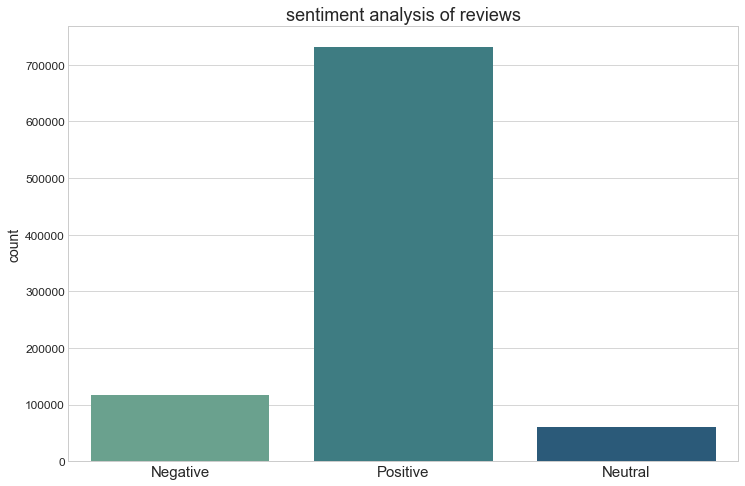

In [61]:
# Graphic of number of listings per neighborhood
plt.figure(figsize=(12,8))
sns.countplot(x='sent_labels',data=review,palette="crest");
plt.title('sentiment analysis of reviews',fontdict={'fontsize':18});
plt.xlabel('');
plt.ylabel('count',fontdict={'fontsize':14});
plt.xticks(fontsize=15)
plt.yticks(fontsize=12)
plt.savefig('../assets/sent_reviews.png')

* Negative reviews
---


In [62]:
neg_reviews_df=review[review['sent_labels']=='Negative']

In [63]:
stop_words= stopwords.words(['spanish','english','french'])
stop_words.append('br')
stop_words.append('automated')

In [64]:
cv8 = CountVectorizer(stop_words=stop_words,ngram_range=(4,4),max_features=1_000,min_df=2)
neg_review_vect = cv8.fit_transform(neg_reviews_df['comments'])
neg_review_vect_df = pd.DataFrame(neg_review_vect.todense(), columns=cv8.get_feature_names())

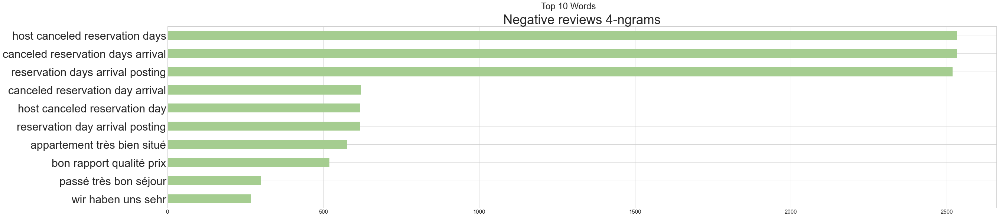

In [65]:
fig, ax = plt.subplots(figsize=(40,9))
neg_review_vect_df.sum().sort_values(ascending=False).head(10).plot(kind='barh', fontsize=14,colormap='crest').invert_yaxis()


plt.title('Negative reviews 4-ngrams', fontsize=35)
plt.xticks(fontsize=15)
plt.yticks(fontsize=30)
fig.suptitle('Top 10 Words', fontsize=24);
plt.savefig('../assets/neg_reviews.png')

* As we saw before, most of the reviews are positive, almost 10% of the reviews are negative and a small percentage is neutral. When analyzing the words of the negative reviews we see a pattern of words such as cancellation of the listings, this shows that the majority of complaints are due to the cancellation of the listing by the host.

### 6. Conclusions:
---

* After analyzing the data provided by Airbnb, we can conclude that in total we have a total of 38,149 listings in New York City, with an average price of 159.4 dollars per night. One of the neighborhoods that has the most listings is Manhattan with a total of 1657 followed by Brooklyn.
* Brooklyn has the most reviews with a total of 389120 reviews, which makes it one of the most popular places in New York, the average price is 132 dollars per night.
 * In general, as the number of guest accommodations increases, the prices of the listings increase, most listings accommodate two people with an average price of 127 dollars per night, the maximum number of accommodations in the listings is 16 guests with a average price of 1026 per night.
* As demonstrated by the graphs of the time series, we saw that the price has a positive trend and that it has a stationary function on a weekly basis. The same case for the availability of the listings.
* In general, most of the reviews are positive, and the negative reviews are most often due to the automatic cancellation of the listings.